In [1]:
from config import parse_args
from model import pggan, stylegan2
from seq_abl import sequential_ablation
from misc import minmax, print_two_images, print_images


import matplotlib.pyplot as plt
import torch
import numpy as np

In [2]:
# random seed
torch.manual_seed(45)
np.random.seed(45)

# 0. Arguments

In [3]:
args = parse_args(jupyter = True)
device = f'cuda:{args.gpu}' if torch.cuda.is_available() else 'cpu'

# 1. Load the Generator

In [4]:
G, _ = stylegan2(args.weight_path, args.resolution)

# 2. Sequential Ablation

In [5]:
# If you already have statistics, then you just load it. Otherwise, you shoulud calculate it before followings.
sq = sequential_ablation(G, device, args)

 75%|███████▌  | 3/4 [00:00<00:00, 24.22it/s]

Frequencies of the neurons are loaded !


100%|██████████| 4/4 [00:00<00:00,  7.13it/s]


In [10]:
# You can save the statistics to resuse it and change the option in config.py.
if True:
    for i in sq.layers:
        np.save(f'./stats/rate_layer{i:d}_{args.dataset}_{args.model}.npy', sq.neurons_freq['layer' + str(i)])

## Histogram of frequency rate of neurons in each layer

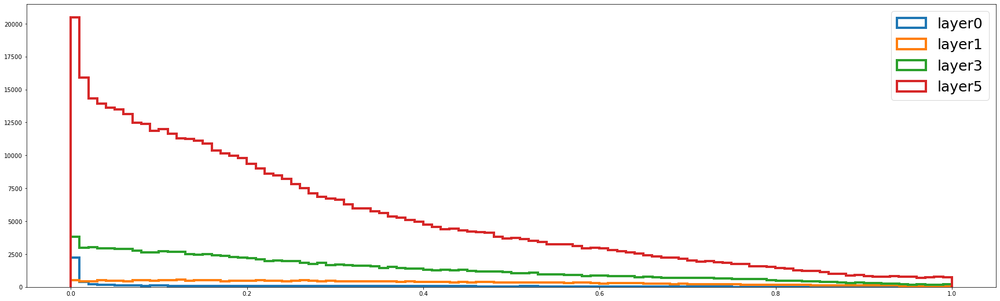

In [7]:
plt.figure(figsize = (30,9))
for i in sq.layers:
    plt.hist(sq.neurons_freq[f'layer{i:d}'], bins = 100, histtype = 'step', linewidth = 4, label = f'layer{i:d}', density = False)
plt.legend(fontsize = 25)
plt.show()

## 2.1 Showing Origin/Corrected Images

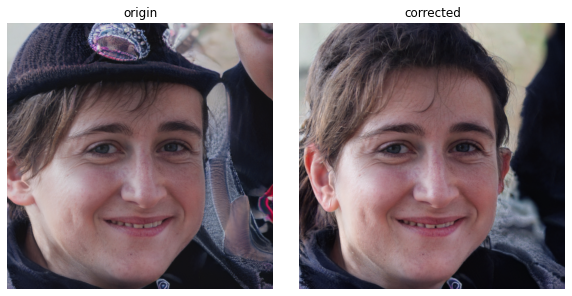

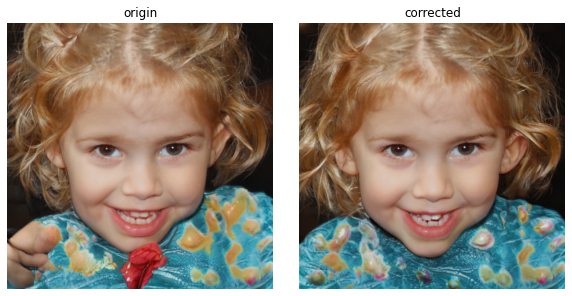

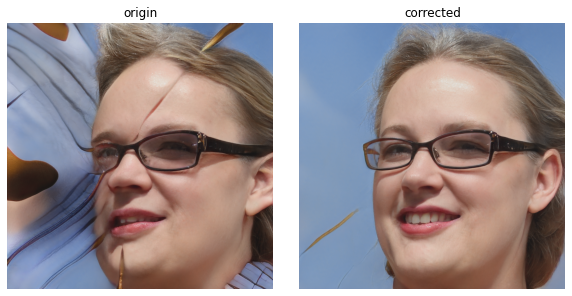

In [9]:
original_image, repaired_image = sq.seq_abl(sample_idx = [1,34,123], layer_idx= [0,1,3], rate = '30', under = True)

for i in range(original_image.size(0)):
    print_two_images(original_image[[i]], repaired_image[[i]], labels = ['origin', 'corrected'])

## 2.2 Artifact Detection

In [26]:
norm, arti = sq.arti_detection(layer_idx = [0,1,3], sample_num = 12000, topn = 60)

100%|██████████| 400/400 [07:35<00:00,  1.14s/it]


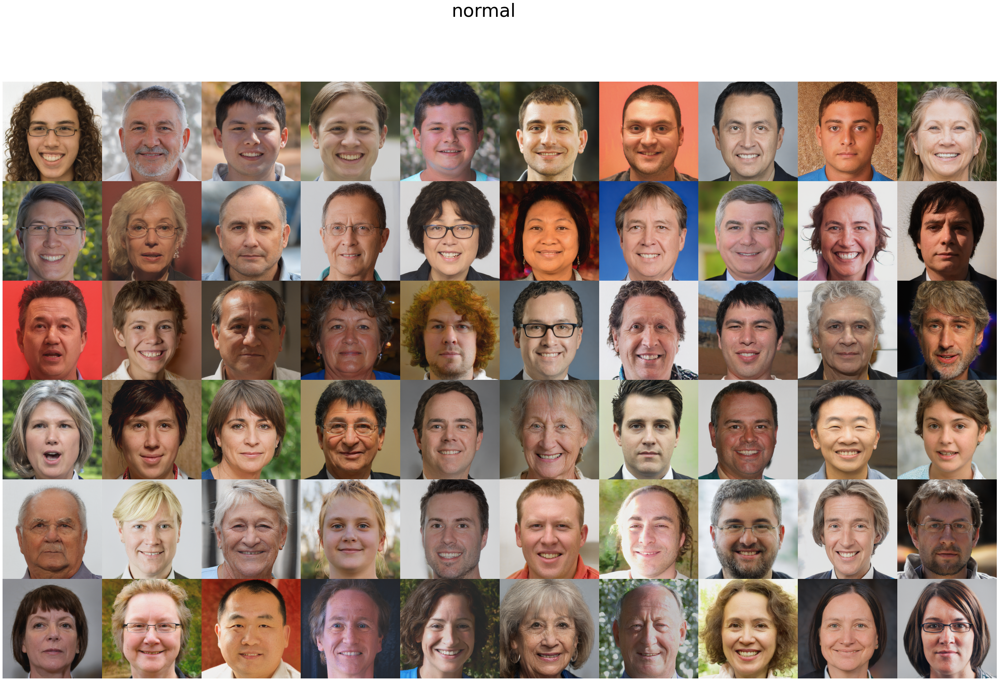

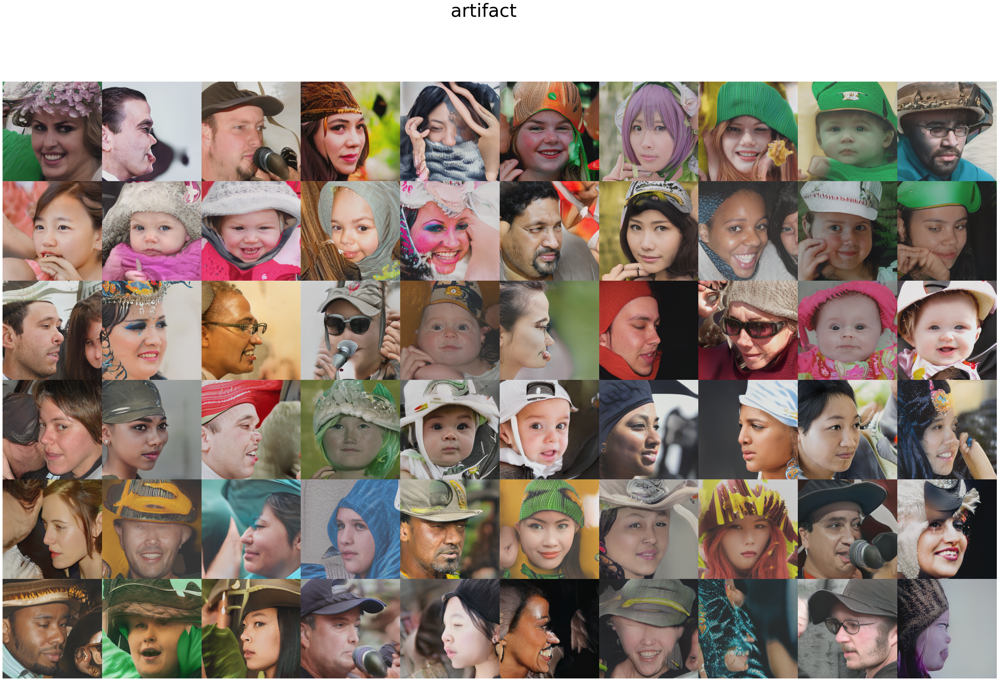

In [27]:
print_images(norm, 'normal')
print_images(arti, 'artifact')